# YET ANOTHER ARCHITECTURE (INSPIRED BY RESNET) - TESTED ON THE BEST COMBINATION OF LOSS + OPTIMIZER

REPLICAS:  1
Epoch 1/10


2024-02-02 14:28:40.368087: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel_1/dropout_10/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer
I0000 00:00:1706884133.576548     100 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


250/250 [==============================] - 287s 999ms/step - loss: 0.0164 - SSIMLoss: 0.5151 - PSNR: inf - val_loss: 0.0476 - val_SSIMLoss: 0.4581 - val_PSNR: 15.4819
Epoch 2/10
250/250 [==============================] - 248s 993ms/step - loss: 0.0111 - SSIMLoss: 0.3806 - PSNR: inf - val_loss: 0.0095 - val_SSIMLoss: 0.1534 - val_PSNR: 22.9109
Epoch 3/10
250/250 [==============================] - 248s 992ms/step - loss: 0.0090 - SSIMLoss: 0.3330 - PSNR: inf - val_loss: 0.0051 - val_SSIMLoss: 0.0816 - val_PSNR: 31.9375
Epoch 4/10
250/250 [==============================] - 248s 992ms/step - loss: 0.0068 - SSIMLoss: 0.3071 - PSNR: inf - val_loss: 0.0051 - val_SSIMLoss: 0.0730 - val_PSNR: 32.0468
Epoch 5/10
250/250 [==============================] - 233s 933ms/step - loss: 0.0050 - SSIMLoss: 0.2824 - PSNR: inf - val_loss: 0.0052 - val_SSIMLoss: 0.0746 - val_PSNR: 31.6517
Epoch 6/10
250/250 [==============================] - 233s 933ms/step - loss: 0.0044 - SSIMLoss: 0.2681 - PSNR: inf - val

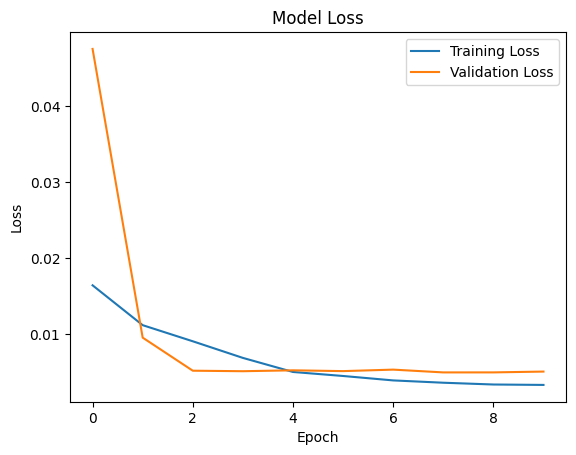

1/1 [==============================] - 0s 249ms/step - loss: 0.0068 - SSIMLoss: 0.0638 - PSNR: 33.8129
Test Loss: [0.006848192308098078, 0.06379270553588867, 33.812896728515625]
1/1 [==============================] - 1s 732ms/step


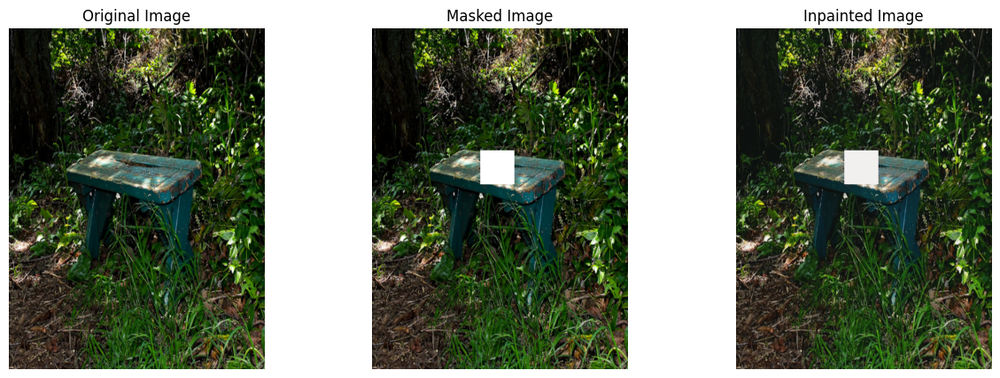

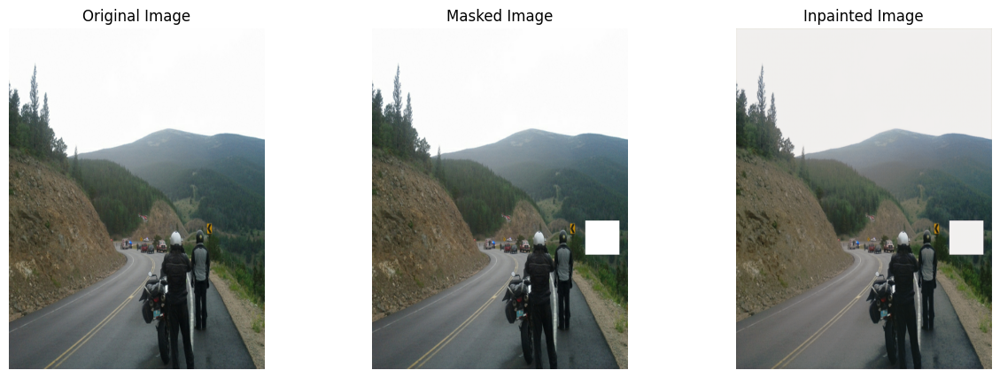

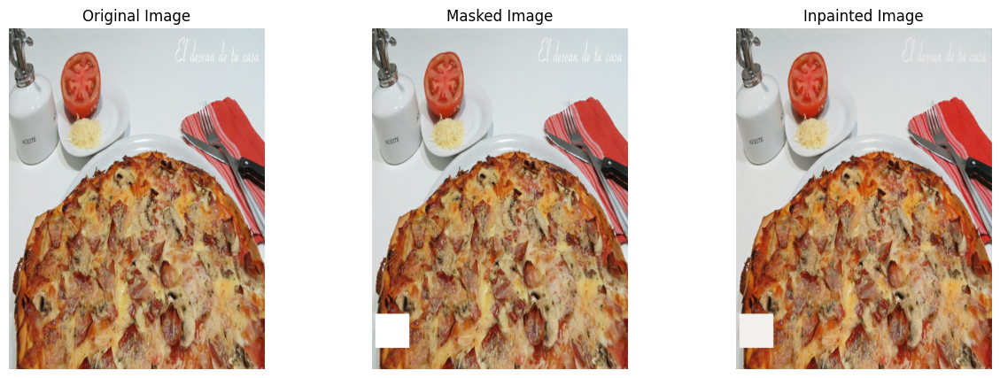

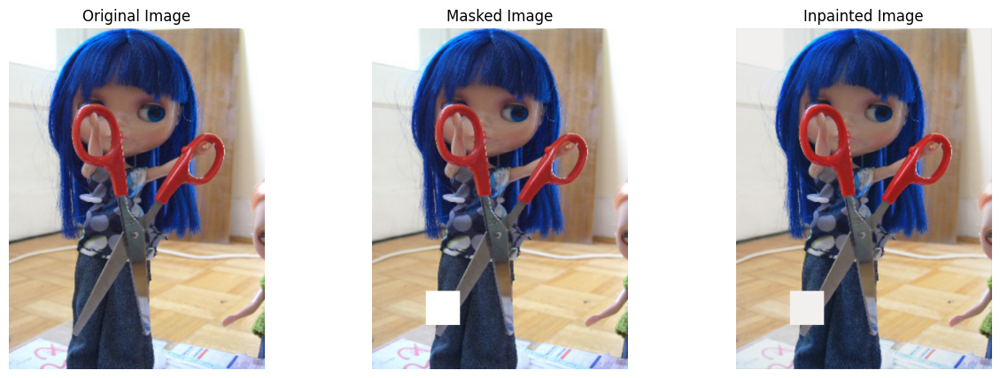

In [3]:
import os
import random
import tensorflow as tf
from tensorflow.keras import layers, models, callbacks
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from keras import backend as K

import matplotlib.pyplot as plt
import numpy as np

from skimage import metrics

def residual_block(input_tensor, num_filters, use_dropout=True, dropout_rate=0.5):
    """Function for a residual block with BatchNormalization, ReLU activation, and optional Dropout"""
    x = layers.Conv2D(num_filters, (3, 3), padding='same')(input_tensor)
    x = layers.BatchNormalization()(x)
    x = layers.Activation('relu')(x)
    x = layers.Conv2D(num_filters, (3, 3), padding='same')(x)
    x = layers.BatchNormalization()(x)

    # Optional: Add Dropout
    if use_dropout:
        x = layers.Dropout(dropout_rate)(x)

    # Ensure the input_shape matches the output shape
    input_shape = input_tensor.get_shape().as_list()
    output_shape = x.get_shape().as_list()
    
    # If shapes of input and output are different, apply 1x1 convolutions to match the dimensions
    if input_shape[-1] != output_shape[-1]:
        input_tensor = layers.Conv2D(num_filters, (1, 1), padding='same')(input_tensor)
        input_tensor = layers.BatchNormalization()(input_tensor)
        input_tensor = layers.Activation('relu')(input_tensor)

    # Add the input (residual connection) to the output of the block
    x = layers.add([x, input_tensor])
    x = layers.Activation('relu')(x)

    return x

def encoder_block(input_tensor, num_filters):
    """Function for the encoder block with residual connections"""
    encoder = residual_block(input_tensor, num_filters)
    encoder_pool = layers.MaxPooling2D((2, 2), strides=(2, 2))(encoder)
    return encoder_pool, encoder

def decoder_block(input_tensor, concat_tensor, num_filters):
    """Function for the decoder block with residual connections"""
    decoder = layers.Conv2DTranspose(num_filters, (2, 2), strides=(2, 2), padding='same')(input_tensor)
    decoder = layers.concatenate([concat_tensor, decoder], axis=-1)
    decoder = residual_block(decoder, num_filters)
    return decoder

def resnet_like_model(input_size):
    inputs = tf.keras.Input(shape=input_size)

    # Encoding path
    encoder0_pool, encoder0 = encoder_block(inputs, 64)
    encoder1_pool, encoder1 = encoder_block(encoder0_pool, 128)
    encoder2_pool, encoder2 = encoder_block(encoder1_pool, 256)
    encoder3_pool, encoder3 = encoder_block(encoder2_pool, 512)

    # Bottleneck
    center = residual_block(encoder3_pool, 1024, use_dropout=True)

    # Decoding path
    decoder3 = decoder_block(center, encoder3, 512)
    decoder2 = decoder_block(decoder3, encoder2, 256)
    decoder1 = decoder_block(decoder2, encoder1, 128)
    decoder0 = decoder_block(decoder1, encoder0, 64)

    # Output layer
    outputs = layers.Conv2D(3, (1, 1), activation='sigmoid')(decoder0)

    model = models.Model(inputs=[inputs], outputs=[outputs])
    return model

# Detect hardware, return appropriate distribution strategy
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()  # TPU detection
    print('Running on TPU ', tpu.master())
except ValueError:
    tpu = None

if tpu:
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)
else:
    strategy = tf.distribute.get_strategy()  # default strategy that works on CPU and single GPU

print("REPLICAS: ", strategy.num_replicas_in_sync)

class InpaintingDataGenerator:
    def __init__(self, image_dir, batch_size, num_samples=None, mask_size=(64, 64), target_size=(256, 256)):
        self.image_dir = image_dir
        self.image_names = os.listdir(image_dir)
        self.batch_size = batch_size
        self.mask_size = mask_size
        self.target_size = target_size
        if num_samples is not None and num_samples < len(self.image_names):
            self.image_names = random.sample(self.image_names, num_samples)
        self.dataset = self.create_dataset()
    
    def create_dataset(self):
        # Create a dataset of file paths
        path_dataset = tf.data.Dataset.from_tensor_slices(self.image_names)

        # Map the file paths to images, masks, and masked images
        image_dataset = path_dataset.map(
            lambda x: self.load_and_preprocess_image(
                self.image_dir, tf.strings.split(x, os.sep)[-1]  # Pass directory and filename separately
            ), 
            num_parallel_calls=tf.data.AUTOTUNE
        )

        # Unpack the tuple into separate elements
        image_dataset = image_dataset.map(lambda x, y: (x, y))

        # Batch and prefetch
        image_dataset = image_dataset.batch(self.batch_size)
        image_dataset = image_dataset.prefetch(buffer_size=tf.data.AUTOTUNE)

        return image_dataset
    
    def load_and_preprocess_image(self, dir_path, filename):
        # Combine the directory and filename to get the full path to the image
        img_path = tf.strings.join([dir_path, filename], separator='/')
        img = tf.io.read_file(img_path)
        img = tf.image.decode_jpeg(img, channels=3)
        img = tf.image.convert_image_dtype(img, tf.float32)
        img = tf.image.resize(img, self.target_size)
        # Create mask
        img_size = tf.shape(img)[:2]
        mask = tf.zeros((img_size[0], img_size[1], 1), dtype=tf.float32)
        top_left_x = tf.random.uniform((), 0, img_size[0] - self.mask_size[0], dtype=tf.int32)
        top_left_y = tf.random.uniform((), 0, img_size[1] - self.mask_size[1], dtype=tf.int32)
        bottom_right_x = top_left_x + self.mask_size[0]
        bottom_right_y = top_left_y + self.mask_size[1]

        # Generate indices for the mask
        indices = tf.reshape(
            tf.stack(
                tf.meshgrid(
                    tf.range(top_left_x, bottom_right_x),
                    tf.range(top_left_y, bottom_right_y),
                    indexing='ij'
                ),
                axis=-1
            ),
            (-1, 2)
        )
    
        # Create updates for the mask
        updates = tf.ones((self.mask_size[0] * self.mask_size[1], 1), dtype=tf.float32)

        # Update the mask tensor
        mask = tf.tensor_scatter_nd_update(mask, indices, updates)

        # Apply mask
        masked_img = img * (1 - mask) + mask

        # Return a tuple of two elements:
        # 1. the masked image (input to the model)
        # 2. the original image (ground truth for training)
        return masked_img, img

# Define directory paths and batch size
train_image_dir = '/kaggle/input/coco2017/train2017'
val_image_dir = '/kaggle/input/coco2017/val2017'
test_image_dir = '/kaggle/input/coco2017/test2017'
batch_size = 4 * strategy.num_replicas_in_sync  # Adjust batch size based on the number of TPU cores

    
# Initialize data generators
train_generator = InpaintingDataGenerator(train_image_dir, batch_size, num_samples=1000, target_size=(640, 480))
val_generator = InpaintingDataGenerator(val_image_dir, batch_size, target_size=(640, 480))
test_generator = InpaintingDataGenerator(test_image_dir, batch_size, target_size=(640, 480))

# losses
def SSIMLoss(y_true, y_pred):
    return 1 - tf.reduce_mean(tf.image.ssim(y_true, y_pred, 1.0))

def PSNR(y_true, y_pred):
    max_pixel = 1.0
    return (10.0 * K.log((max_pixel ** 2) / (K.mean(K.square(y_pred - y_true), axis=-1)))) / 2.303


# Initialize the complex U-Net model within the TPU strategy scope
with strategy.scope():
    final_model = resnet_like_model(input_size=(640, 480, 3))
    # It's crucial to compile the model within the strategy scope.
    final_model.compile(optimizer='rmsprop', loss='mse', metrics=[SSIMLoss,PSNR])

 
# Initialize callbacks
callbacks = [
    ModelCheckpoint('best_inpainting_model.tf', monitor='val_loss', save_best_only=True),
    EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
]


# Train the model
history = final_model.fit(
    train_generator.dataset,
    epochs=10,  # Training for 3 epochs as an example
    steps_per_epoch=min(1000, len(train_generator.image_names)) // batch_size,
    validation_data=val_generator.dataset,
    validation_steps=min(300, len(val_generator.image_names)) // batch_size,
    callbacks=callbacks
)


# Plot training history
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()
plt.show()

# Evaluate on test set
for sample in test_generator.dataset.take(1):
    masked_images, original_images = sample
    test_loss = final_model.evaluate(masked_images, original_images)
    print(f'Test Loss: {test_loss}')

# Display inpainting results
def display_inpainting_results(model, generator, num_samples=3):
    # Take one batch from the dataset
    for sample in generator.dataset.take(1):
        masked_images, original_images = sample

        # Predict inpainted images
        inpainted_images = model.predict(masked_images)

        # Display the results for the specified number of samples
        for i in range(min(num_samples, masked_images.shape[0])):
            plt.figure(figsize=(15, 5))
            
            # Display original image
            plt.subplot(1, 3, 1)
            plt.imshow(original_images[i].numpy() if isinstance(original_images[i], tf.Tensor) else original_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Original Image')
            plt.axis('off')
            
            # Display masked image
            plt.subplot(1, 3, 2)
            plt.imshow(masked_images[i].numpy() if isinstance(masked_images[i], tf.Tensor) else masked_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Masked Image')
            plt.axis('off')
            
            # Display inpainted image
            plt.subplot(1, 3, 3)
            plt.imshow(inpainted_images[i].numpy() if isinstance(inpainted_images[i], tf.Tensor) else inpainted_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Inpainted Image')
            plt.axis('off')
            plt.show()

display_inpainting_results(final_model, test_generator, num_samples=6)

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_4 (InputLayer)        [(None, 640, 480, 3)]        0         []                            
                                                                                                  
 conv2d_58 (Conv2D)          (None, 640, 480, 64)         1792      ['input_4[0][0]']             
                                                                                                  
 batch_normalization_56 (Ba  (None, 640, 480, 64)         256       ['conv2d_58[0][0]']           
 tchNormalization)                                                                                
                                                                                                  
 activation_55 (Activation)  (None, 640, 480, 64)         0         ['batch_normalization_56

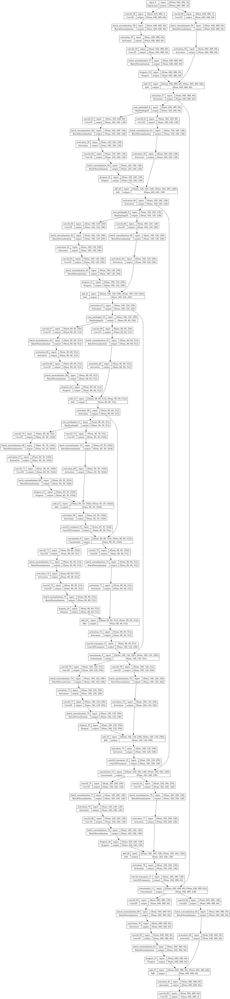

In [5]:
# Instantiate the model
model = resnet_like_model(input_size=(640, 480, 3))

# Display the model summary
model.summary()

# Visualize the model architecture
tf.keras.utils.plot_model(model, to_file='model_architecture.png', show_shapes=True, show_layer_names=True)

# TESTING NEW OPTIMISER

# MSE + ADAGRAD

REPLICAS:  1
1/1 [==============================] - 4s 4s/step
Shape of dummy_output directly after model definition: (1, 640, 480, 3)
Epoch 1/10


I0000 00:00:1706880629.019520     218 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


125/125 [==============================] - 109s 643ms/step - loss: 0.0905 - SSIMLoss: 0.8972 - val_loss: 0.0890 - val_SSIMLoss: 0.6664
Epoch 2/10
125/125 [==============================] - 79s 636ms/step - loss: 0.0592 - SSIMLoss: 0.8478 - val_loss: 0.0830 - val_SSIMLoss: 0.7672
Epoch 3/10
125/125 [==============================] - 79s 636ms/step - loss: 0.0461 - SSIMLoss: 0.8063 - val_loss: 0.0580 - val_SSIMLoss: 0.7754
Epoch 4/10
125/125 [==============================] - 79s 636ms/step - loss: 0.0386 - SSIMLoss: 0.7718 - val_loss: 0.0362 - val_SSIMLoss: 0.7360
Epoch 5/10
125/125 [==============================] - 80s 638ms/step - loss: 0.0336 - SSIMLoss: 0.7430 - val_loss: 0.0282 - val_SSIMLoss: 0.7083
Epoch 6/10
125/125 [==============================] - 79s 635ms/step - loss: 0.0301 - SSIMLoss: 0.7186 - val_loss: 0.0254 - val_SSIMLoss: 0.6928
Epoch 7/10
125/125 [==============================] - 79s 635ms/step - loss: 0.0274 - SSIMLoss: 0.6973 - val_loss: 0.0237 - val_SSIMLoss: 0.

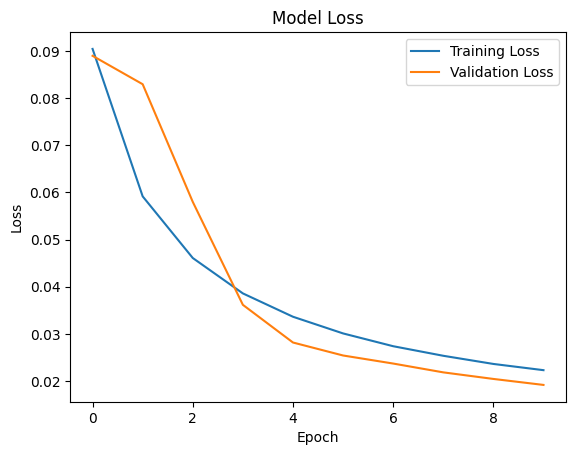

1/1 [==============================] - 0s 227ms/step - loss: 0.0195 - SSIMLoss: 0.6112
Test Loss: [0.019548719748854637, 0.6112474203109741]
1/1 [==============================] - 0s 57ms/step


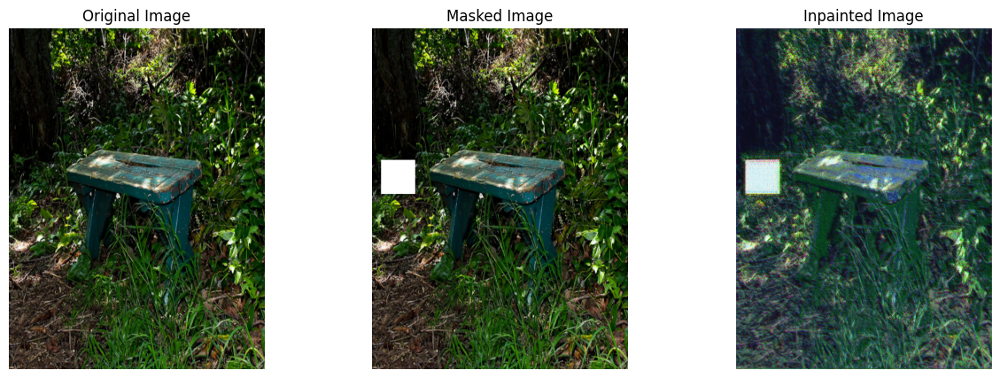

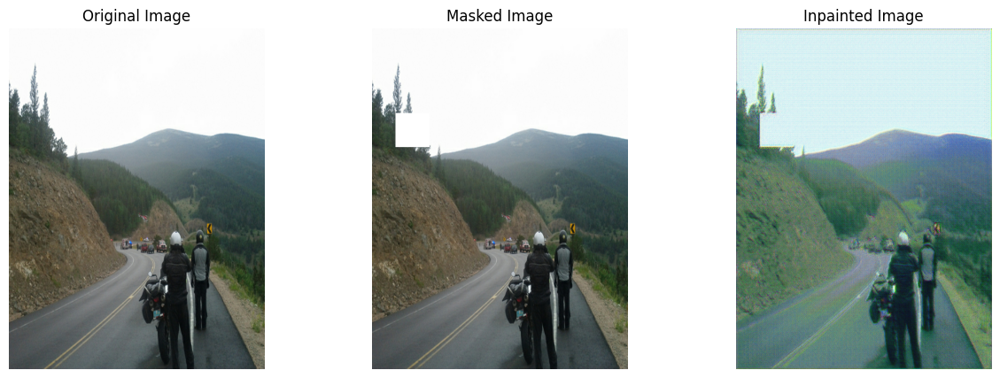

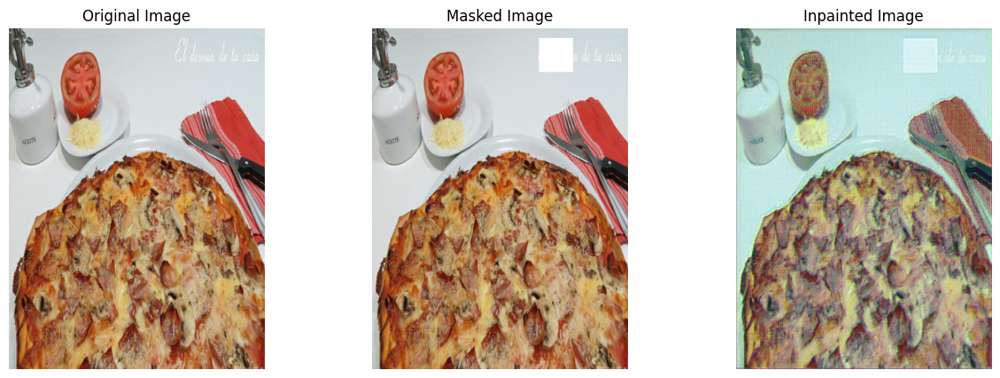

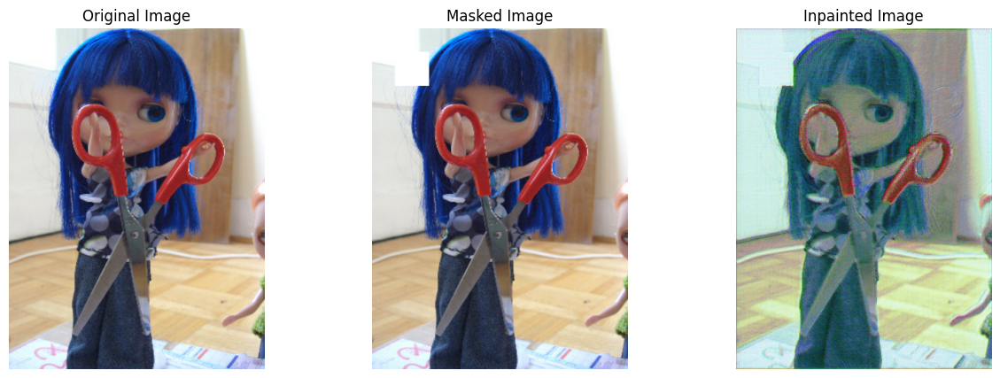

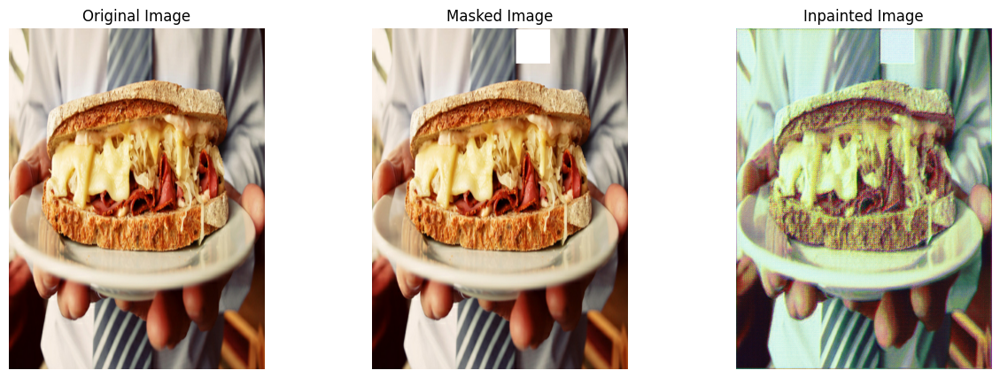

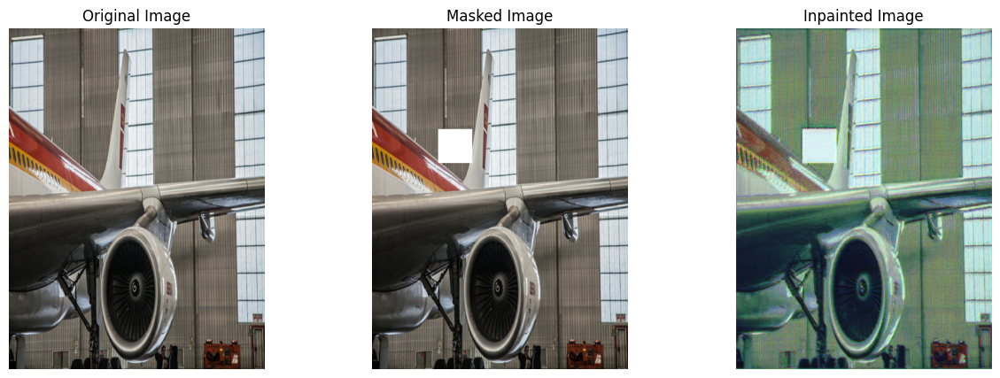

In [2]:
import os
import random
import tensorflow as tf
from tensorflow.keras import layers, models, callbacks
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from keras import backend as K

import matplotlib.pyplot as plt
import numpy as np

from skimage import metrics


def conv_block(input_tensor, num_filters):
    """Function for a convolutional block with BatchNormalization and ReLU activation"""
    encoder = layers.Conv2D(num_filters, (3, 3), padding='same')(input_tensor)
    encoder = layers.BatchNormalization()(encoder)
    encoder = layers.Activation('relu')(encoder)
    encoder = layers.Conv2D(num_filters, (3, 3), padding='same')(encoder)
    encoder = layers.BatchNormalization()(encoder)
    encoder = layers.Activation('relu')(encoder)
    return encoder

def encoder_block(input_tensor, num_filters):
    """Function for the encoder block"""
    encoder = conv_block(input_tensor, num_filters)
    encoder_pool = layers.MaxPooling2D((2, 2), strides=(2, 2))(encoder)
    return encoder_pool, encoder

def decoder_block(input_tensor, concat_tensor, num_filters):
    """Function for the decoder block"""
    decoder = layers.Conv2DTranspose(num_filters, (2, 2), strides=(2, 2), padding='same')(input_tensor)
    decoder = layers.concatenate([concat_tensor, decoder], axis=-1)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    decoder = layers.Conv2D(num_filters, (3, 3), padding='same')(decoder)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    decoder = layers.Conv2D(num_filters, (3, 3), padding='same')(decoder)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    return decoder

def unet_complex(input_size):
    inputs = tf.keras.Input(shape=input_size)

    # Encoding path
    encoder0_pool, encoder0 = encoder_block(inputs, 32)
    encoder1_pool, encoder1 = encoder_block(encoder0_pool, 64)
    encoder2_pool, encoder2 = encoder_block(encoder1_pool, 128)
    encoder3_pool, encoder3 = encoder_block(encoder2_pool, 256)
    encoder4_pool, encoder4 = encoder_block(encoder3_pool, 512)

    # Bottleneck
    center = conv_block(encoder4_pool, 1024)

    # Decoding path
    decoder4 = decoder_block(center, encoder4, 512)
    decoder3 = decoder_block(decoder4, encoder3, 256)
    decoder2 = decoder_block(decoder3, encoder2, 128)
    decoder1 = decoder_block(decoder2, encoder1, 64)
    decoder0 = decoder_block(decoder1, encoder0, 32)

    # Output layer
    outputs = layers.Conv2D(3, (1, 1), activation='sigmoid')(decoder0)  # Adjusted the output layer

    model = models.Model(inputs=[inputs], outputs=[outputs])
    return model



# Detect hardware, return appropriate distribution strategy
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()  # TPU detection
    print('Running on TPU ', tpu.master())
except ValueError:
    tpu = None

if tpu:
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)
else:
    strategy = tf.distribute.get_strategy()  # default strategy that works on CPU and single GPU

print("REPLICAS: ", strategy.num_replicas_in_sync)

class InpaintingDataGenerator:
    def __init__(self, image_dir, batch_size, num_samples=None, mask_size=(64, 64), target_size=(256, 256)):
        self.image_dir = image_dir
        self.image_names = os.listdir(image_dir)
        self.batch_size = batch_size
        self.mask_size = mask_size
        self.target_size = target_size
        if num_samples is not None and num_samples < len(self.image_names):
            self.image_names = random.sample(self.image_names, num_samples)
        self.dataset = self.create_dataset()
    
    def create_dataset(self):
        # Create a dataset of file paths
        path_dataset = tf.data.Dataset.from_tensor_slices(self.image_names)

        # Map the file paths to images, masks, and masked images
        image_dataset = path_dataset.map(
            lambda x: self.load_and_preprocess_image(
                self.image_dir, tf.strings.split(x, os.sep)[-1]  # Pass directory and filename separately
            ), 
            num_parallel_calls=tf.data.AUTOTUNE
        )

        # Unpack the tuple into separate elements
        image_dataset = image_dataset.map(lambda x, y: (x, y))

        # Batch and prefetch
        image_dataset = image_dataset.batch(self.batch_size)
        image_dataset = image_dataset.prefetch(buffer_size=tf.data.AUTOTUNE)

        return image_dataset
    
    def load_and_preprocess_image(self, dir_path, filename):
        # Combine the directory and filename to get the full path to the image
        img_path = tf.strings.join([dir_path, filename], separator='/')
        img = tf.io.read_file(img_path)
        img = tf.image.decode_jpeg(img, channels=3)
        img = tf.image.convert_image_dtype(img, tf.float32)
        img = tf.image.resize(img, self.target_size)
        # Create mask
        img_size = tf.shape(img)[:2]
        mask = tf.zeros((img_size[0], img_size[1], 1), dtype=tf.float32)
        top_left_x = tf.random.uniform((), 0, img_size[0] - self.mask_size[0], dtype=tf.int32)
        top_left_y = tf.random.uniform((), 0, img_size[1] - self.mask_size[1], dtype=tf.int32)
        bottom_right_x = top_left_x + self.mask_size[0]
        bottom_right_y = top_left_y + self.mask_size[1]

        # Generate indices for the mask
        indices = tf.reshape(
            tf.stack(
                tf.meshgrid(
                    tf.range(top_left_x, bottom_right_x),
                    tf.range(top_left_y, bottom_right_y),
                    indexing='ij'
                ),
                axis=-1
            ),
            (-1, 2)
        )
    
        # Create updates for the mask
        updates = tf.ones((self.mask_size[0] * self.mask_size[1], 1), dtype=tf.float32)

        # Update the mask tensor
        mask = tf.tensor_scatter_nd_update(mask, indices, updates)

        # Apply mask
        masked_img = img * (1 - mask) + mask

        # Return a tuple of two elements:
        # 1. the masked image (input to the model)
        # 2. the original image (ground truth for training)
        return masked_img, img

# Define directory paths and batch size
train_image_dir = '/kaggle/input/coco2017/train2017'
val_image_dir = '/kaggle/input/coco2017/val2017'
test_image_dir = '/kaggle/input/coco2017/test2017'
batch_size = 8 * strategy.num_replicas_in_sync  # Adjust batch size based on the number of TPU cores

    
# Initialize data generators
train_generator = InpaintingDataGenerator(train_image_dir, batch_size, num_samples=1000, target_size=(640, 480))
val_generator = InpaintingDataGenerator(val_image_dir, batch_size, target_size=(640, 480))
test_generator = InpaintingDataGenerator(test_image_dir, batch_size, target_size=(640, 480))

# losses
# check also mae i msa
# save all of the models for comparison
def SSIMLoss(y_true, y_pred):
    return 1 - tf.reduce_mean(tf.image.ssim(y_true, y_pred, 1.0))

def PSNR(y_true, y_pred):
    max_pixel = 1.0
    return (10.0 * K.log((max_pixel ** 2) / (K.mean(K.square(y_pred - y_true), axis=-1)))) / 2.303


# Initialize the complex U-Net model within the TPU strategy scope
with strategy.scope():
    final_model = unet_complex(input_size=(640, 480, 3))
    # It's crucial to compile the model within the strategy scope.
    final_model.compile(optimizer='adagrad', loss='mse', metrics=[SSIMLoss])

    # After compiling, make a dummy prediction to check the output shape.
    dummy_input = tf.random.normal((1, 640, 480, 3))
    dummy_output = final_model.predict(dummy_input)
    print("Shape of dummy_output directly after model definition:", dummy_output.shape)

# Initialize callbacks
callbacks = [
    ModelCheckpoint('best_inpainting_model.tf', monitor='val_loss', save_best_only=True),
    EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
]


# Train the model
history = final_model.fit(
    train_generator.dataset,
    epochs=10,  # Training for 3 epochs as an example
    steps_per_epoch=min(1000, len(train_generator.image_names)) // batch_size,
    validation_data=val_generator.dataset,
    validation_steps=min(300, len(val_generator.image_names)) // batch_size,
    callbacks=callbacks
)


# Plot training history
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()
plt.show()

# # Evaluate on test set
# test_loss = final_model.evaluate(
#     test_generator.dataset,
#     steps=len(test_generator.image_names) // batch_size
# )

# Evaluate on test set
for sample in test_generator.dataset.take(1):
    masked_images, original_images = sample
    test_loss = final_model.evaluate(masked_images, original_images)
    print(f'Test Loss: {test_loss}')

# Display inpainting results
def display_inpainting_results(model, generator, num_samples=3):
    # Take one batch from the dataset
    for sample in generator.dataset.take(1):
        masked_images, original_images = sample

        # Predict inpainted images
        inpainted_images = model.predict(masked_images)

        # Display the results for the specified number of samples
        for i in range(min(num_samples, masked_images.shape[0])):
            plt.figure(figsize=(15, 5))
            
            # Display original image
            plt.subplot(1, 3, 1)
            plt.imshow(original_images[i].numpy() if isinstance(original_images[i], tf.Tensor) else original_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Original Image')
            plt.axis('off')
            
            # Display masked image
            plt.subplot(1, 3, 2)
            plt.imshow(masked_images[i].numpy() if isinstance(masked_images[i], tf.Tensor) else masked_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Masked Image')
            plt.axis('off')
            
            # Display inpainted image
            plt.subplot(1, 3, 3)
            plt.imshow(inpainted_images[i].numpy() if isinstance(inpainted_images[i], tf.Tensor) else inpainted_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Inpainted Image')
            plt.axis('off')
            plt.show()

display_inpainting_results(final_model, test_generator, num_samples=6)

# MAE + ADAGRAD

REPLICAS:  1
1/1 [==============================] - 2s 2s/step
Shape of dummy_output directly after model definition: (1, 640, 480, 3)
Epoch 1/10
125/125 [==============================] - 111s 655ms/step - loss: 0.2023 - SSIMLoss: 0.8911 - val_loss: 0.2374 - val_SSIMLoss: 0.6693
Epoch 2/10
125/125 [==============================] - 81s 648ms/step - loss: 0.1464 - SSIMLoss: 0.8006 - val_loss: 0.1930 - val_SSIMLoss: 0.7067
Epoch 3/10
125/125 [==============================] - 81s 646ms/step - loss: 0.1240 - SSIMLoss: 0.7370 - val_loss: 0.1299 - val_SSIMLoss: 0.6684
Epoch 4/10
125/125 [==============================] - 81s 647ms/step - loss: 0.1109 - SSIMLoss: 0.6907 - val_loss: 0.0956 - val_SSIMLoss: 0.6232
Epoch 5/10
125/125 [==============================] - 80s 639ms/step - loss: 0.1021 - SSIMLoss: 0.6542 - val_loss: 0.0856 - val_SSIMLoss: 0.6098
Epoch 6/10
125/125 [==============================] - 81s 652ms/step - loss: 0.0956 - SSIMLoss: 0.6233 - val_loss: 0.0823 - val_SSIMLoss: 0

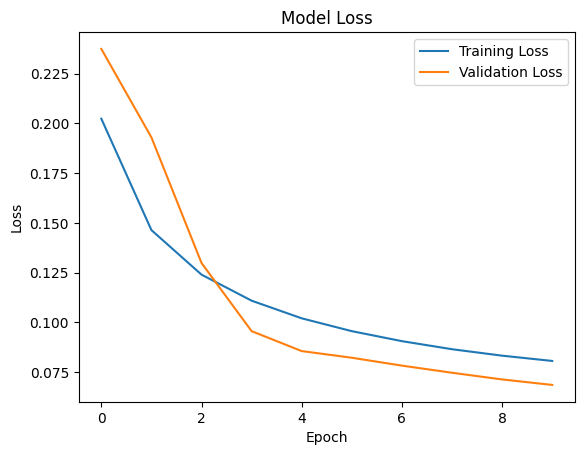

1/1 [==============================] - 0s 233ms/step - loss: 0.0691 - SSIMLoss: 0.4987
Test Loss: [0.06907442212104797, 0.4986521005630493]
1/1 [==============================] - 0s 52ms/step


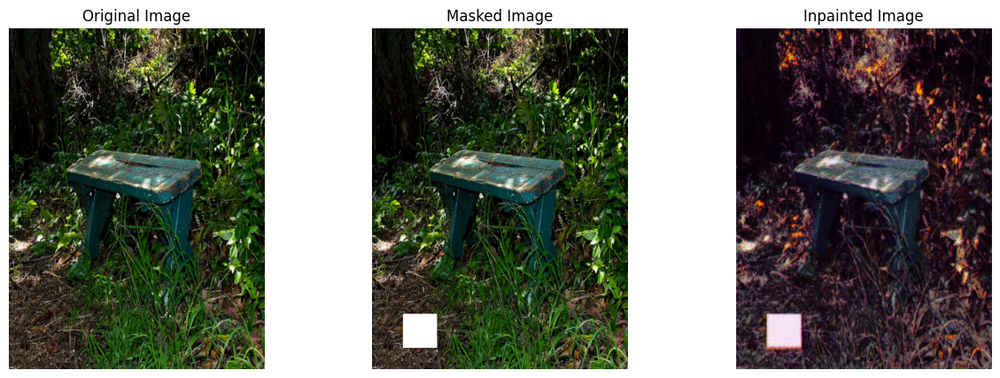

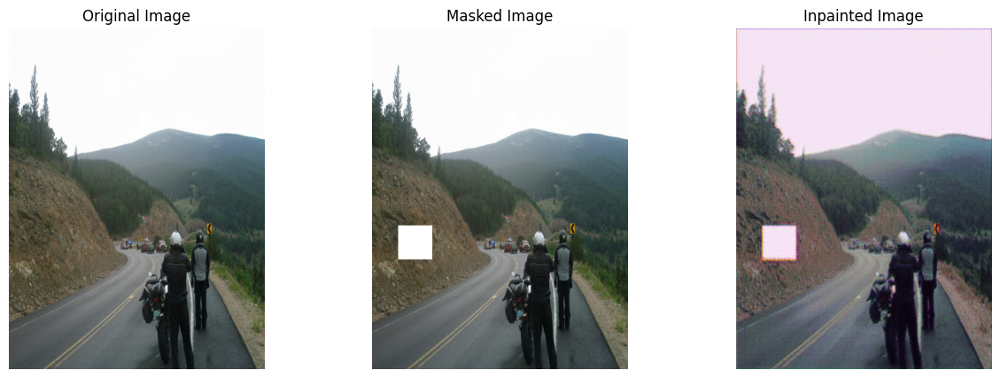

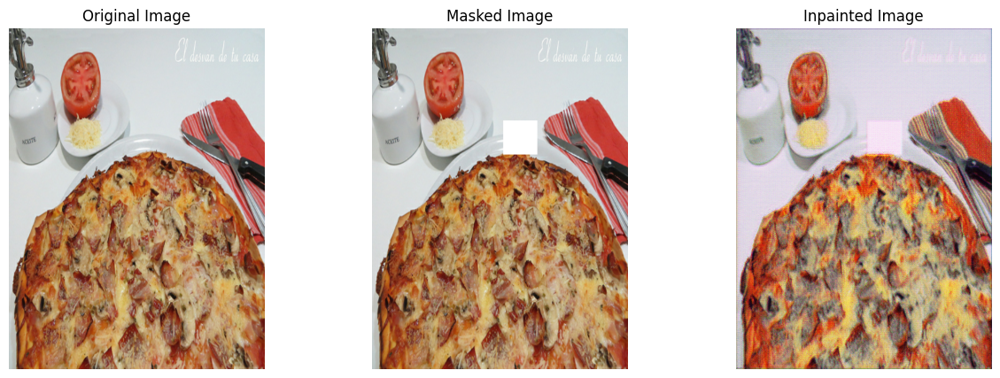

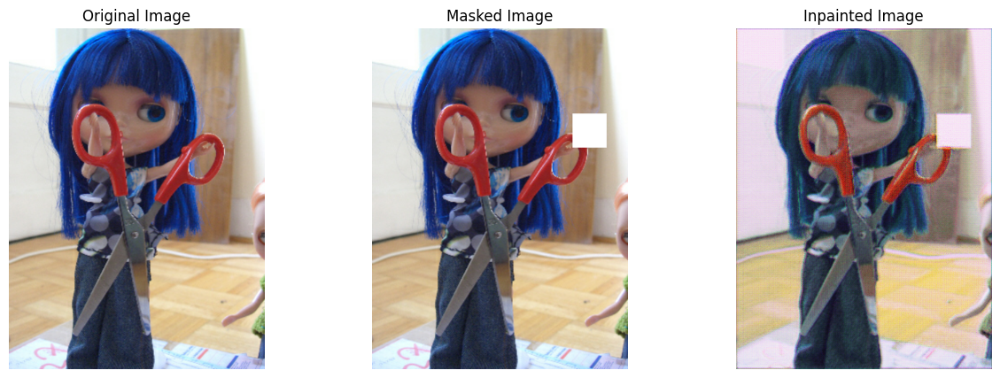

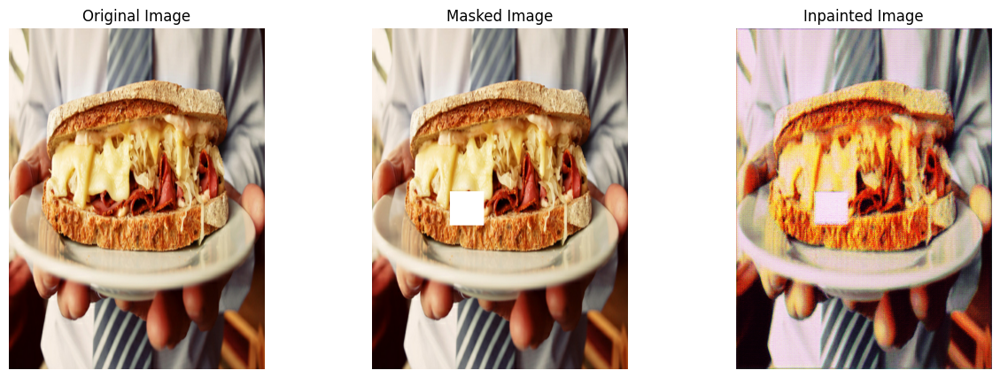

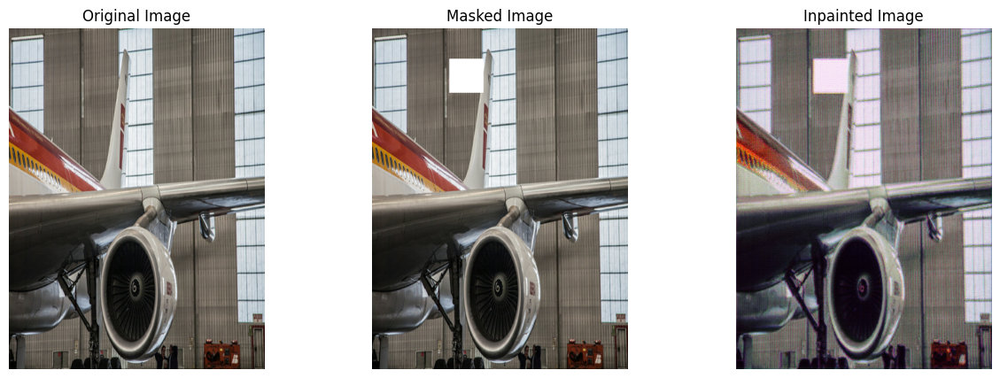

In [13]:
import os
import random
import tensorflow as tf
from tensorflow.keras import layers, models, callbacks
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from keras import backend as K

import matplotlib.pyplot as plt
import numpy as np

from skimage import metrics


def conv_block(input_tensor, num_filters):
    """Function for a convolutional block with BatchNormalization and ReLU activation"""
    encoder = layers.Conv2D(num_filters, (3, 3), padding='same')(input_tensor)
    encoder = layers.BatchNormalization()(encoder)
    encoder = layers.Activation('relu')(encoder)
    encoder = layers.Conv2D(num_filters, (3, 3), padding='same')(encoder)
    encoder = layers.BatchNormalization()(encoder)
    encoder = layers.Activation('relu')(encoder)
    return encoder

def encoder_block(input_tensor, num_filters):
    """Function for the encoder block"""
    encoder = conv_block(input_tensor, num_filters)
    encoder_pool = layers.MaxPooling2D((2, 2), strides=(2, 2))(encoder)
    return encoder_pool, encoder

def decoder_block(input_tensor, concat_tensor, num_filters):
    """Function for the decoder block"""
    decoder = layers.Conv2DTranspose(num_filters, (2, 2), strides=(2, 2), padding='same')(input_tensor)
    decoder = layers.concatenate([concat_tensor, decoder], axis=-1)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    decoder = layers.Conv2D(num_filters, (3, 3), padding='same')(decoder)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    decoder = layers.Conv2D(num_filters, (3, 3), padding='same')(decoder)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    return decoder

def unet_complex(input_size):
    inputs = tf.keras.Input(shape=input_size)

    # Encoding path
    encoder0_pool, encoder0 = encoder_block(inputs, 32)
    encoder1_pool, encoder1 = encoder_block(encoder0_pool, 64)
    encoder2_pool, encoder2 = encoder_block(encoder1_pool, 128)
    encoder3_pool, encoder3 = encoder_block(encoder2_pool, 256)
    encoder4_pool, encoder4 = encoder_block(encoder3_pool, 512)

    # Bottleneck
    center = conv_block(encoder4_pool, 1024)

    # Decoding path
    decoder4 = decoder_block(center, encoder4, 512)
    decoder3 = decoder_block(decoder4, encoder3, 256)
    decoder2 = decoder_block(decoder3, encoder2, 128)
    decoder1 = decoder_block(decoder2, encoder1, 64)
    decoder0 = decoder_block(decoder1, encoder0, 32)

    # Output layer
    outputs = layers.Conv2D(3, (1, 1), activation='sigmoid')(decoder0)  # Adjusted the output layer

    model = models.Model(inputs=[inputs], outputs=[outputs])
    return model



# Detect hardware, return appropriate distribution strategy
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()  # TPU detection
    print('Running on TPU ', tpu.master())
except ValueError:
    tpu = None

if tpu:
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)
else:
    strategy = tf.distribute.get_strategy()  # default strategy that works on CPU and single GPU

print("REPLICAS: ", strategy.num_replicas_in_sync)

class InpaintingDataGenerator:
    def __init__(self, image_dir, batch_size, num_samples=None, mask_size=(64, 64), target_size=(256, 256)):
        self.image_dir = image_dir
        self.image_names = os.listdir(image_dir)
        self.batch_size = batch_size
        self.mask_size = mask_size
        self.target_size = target_size
        if num_samples is not None and num_samples < len(self.image_names):
            self.image_names = random.sample(self.image_names, num_samples)
        self.dataset = self.create_dataset()
    
    def create_dataset(self):
        # Create a dataset of file paths
        path_dataset = tf.data.Dataset.from_tensor_slices(self.image_names)

        # Map the file paths to images, masks, and masked images
        image_dataset = path_dataset.map(
            lambda x: self.load_and_preprocess_image(
                self.image_dir, tf.strings.split(x, os.sep)[-1]  # Pass directory and filename separately
            ), 
            num_parallel_calls=tf.data.AUTOTUNE
        )

        # Unpack the tuple into separate elements
        image_dataset = image_dataset.map(lambda x, y: (x, y))

        # Batch and prefetch
        image_dataset = image_dataset.batch(self.batch_size)
        image_dataset = image_dataset.prefetch(buffer_size=tf.data.AUTOTUNE)

        return image_dataset
    
    def load_and_preprocess_image(self, dir_path, filename):
        # Combine the directory and filename to get the full path to the image
        img_path = tf.strings.join([dir_path, filename], separator='/')
        img = tf.io.read_file(img_path)
        img = tf.image.decode_jpeg(img, channels=3)
        img = tf.image.convert_image_dtype(img, tf.float32)
        img = tf.image.resize(img, self.target_size)
        # Create mask
        img_size = tf.shape(img)[:2]
        mask = tf.zeros((img_size[0], img_size[1], 1), dtype=tf.float32)
        top_left_x = tf.random.uniform((), 0, img_size[0] - self.mask_size[0], dtype=tf.int32)
        top_left_y = tf.random.uniform((), 0, img_size[1] - self.mask_size[1], dtype=tf.int32)
        bottom_right_x = top_left_x + self.mask_size[0]
        bottom_right_y = top_left_y + self.mask_size[1]

        # Generate indices for the mask
        indices = tf.reshape(
            tf.stack(
                tf.meshgrid(
                    tf.range(top_left_x, bottom_right_x),
                    tf.range(top_left_y, bottom_right_y),
                    indexing='ij'
                ),
                axis=-1
            ),
            (-1, 2)
        )
    
        # Create updates for the mask
        updates = tf.ones((self.mask_size[0] * self.mask_size[1], 1), dtype=tf.float32)

        # Update the mask tensor
        mask = tf.tensor_scatter_nd_update(mask, indices, updates)

        # Apply mask
        masked_img = img * (1 - mask) + mask

        # Return a tuple of two elements:
        # 1. the masked image (input to the model)
        # 2. the original image (ground truth for training)
        return masked_img, img

# Define directory paths and batch size
train_image_dir = '/kaggle/input/coco2017/train2017'
val_image_dir = '/kaggle/input/coco2017/val2017'
test_image_dir = '/kaggle/input/coco2017/test2017'
batch_size = 8 * strategy.num_replicas_in_sync  # Adjust batch size based on the number of TPU cores

    
# Initialize data generators
train_generator = InpaintingDataGenerator(train_image_dir, batch_size, num_samples=1000, target_size=(640, 480))
val_generator = InpaintingDataGenerator(val_image_dir, batch_size, target_size=(640, 480))
test_generator = InpaintingDataGenerator(test_image_dir, batch_size, target_size=(640, 480))

# losses
# check also mae i msa
# save all of the models for comparison
def SSIMLoss(y_true, y_pred):
    return 1 - tf.reduce_mean(tf.image.ssim(y_true, y_pred, 1.0))

def PSNR(y_true, y_pred):
    max_pixel = 1.0
    return (10.0 * K.log((max_pixel ** 2) / (K.mean(K.square(y_pred - y_true), axis=-1)))) / 2.303


# Initialize the complex U-Net model within the TPU strategy scope
with strategy.scope():
    final_model = unet_complex(input_size=(640, 480, 3))
    # It's crucial to compile the model within the strategy scope.
    final_model.compile(optimizer='adagrad', loss='mae', metrics=[SSIMLoss])

    # After compiling, make a dummy prediction to check the output shape.
    dummy_input = tf.random.normal((1, 640, 480, 3))
    dummy_output = final_model.predict(dummy_input)
    print("Shape of dummy_output directly after model definition:", dummy_output.shape)

# Initialize callbacks
callbacks = [
    ModelCheckpoint('best_inpainting_model.tf', monitor='val_loss', save_best_only=True),
    EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
]


# Train the model
history = final_model.fit(
    train_generator.dataset,
    epochs=10,  # Training for 3 epochs as an example
    steps_per_epoch=min(1000, len(train_generator.image_names)) // batch_size,
    validation_data=val_generator.dataset,
    validation_steps=min(300, len(val_generator.image_names)) // batch_size,
    callbacks=callbacks
)


# Plot training history
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()
plt.show()

# Evaluate on test set
for sample in test_generator.dataset.take(1):
    masked_images, original_images = sample
    test_loss = final_model.evaluate(masked_images, original_images)
    print(f'Test Loss: {test_loss}')

# Display inpainting results
def display_inpainting_results(model, generator, num_samples=3):
    # Take one batch from the dataset
    for sample in generator.dataset.take(1):
        masked_images, original_images = sample

        # Predict inpainted images
        inpainted_images = model.predict(masked_images)

        # Display the results for the specified number of samples
        for i in range(min(num_samples, masked_images.shape[0])):
            plt.figure(figsize=(15, 5))
            
            # Display original image
            plt.subplot(1, 3, 1)
            plt.imshow(original_images[i].numpy() if isinstance(original_images[i], tf.Tensor) else original_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Original Image')
            plt.axis('off')
            
            # Display masked image
            plt.subplot(1, 3, 2)
            plt.imshow(masked_images[i].numpy() if isinstance(masked_images[i], tf.Tensor) else masked_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Masked Image')
            plt.axis('off')
            
            # Display inpainted image
            plt.subplot(1, 3, 3)
            plt.imshow(inpainted_images[i].numpy() if isinstance(inpainted_images[i], tf.Tensor) else inpainted_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Inpainted Image')
            plt.axis('off')
            plt.show()

display_inpainting_results(final_model, test_generator, num_samples=6)

# SSIMLOSS + ADAGRAD

REPLICAS:  1
1/1 [==============================] - 1s 658ms/step
Shape of dummy_output directly after model definition: (1, 640, 480, 3)
Epoch 1/12
125/125 [==============================] - 98s 700ms/step - loss: 0.8260 - SSIMLoss: 0.8260 - val_loss: 0.6043 - val_SSIMLoss: 0.6043
Epoch 2/12
125/125 [==============================] - 86s 693ms/step - loss: 0.5582 - SSIMLoss: 0.5582 - val_loss: 0.4917 - val_SSIMLoss: 0.4917
Epoch 3/12
125/125 [==============================] - 86s 690ms/step - loss: 0.4273 - SSIMLoss: 0.4273 - val_loss: 0.3724 - val_SSIMLoss: 0.3724
Epoch 4/12
125/125 [==============================] - 85s 684ms/step - loss: 0.3642 - SSIMLoss: 0.3642 - val_loss: 0.3145 - val_SSIMLoss: 0.3145
Epoch 5/12
125/125 [==============================] - 87s 698ms/step - loss: 0.3221 - SSIMLoss: 0.3221 - val_loss: 0.2927 - val_SSIMLoss: 0.2927
Epoch 6/12
125/125 [==============================] - 86s 688ms/step - loss: 0.2904 - SSIMLoss: 0.2904 - val_loss: 0.2769 - val_SSIMLoss:

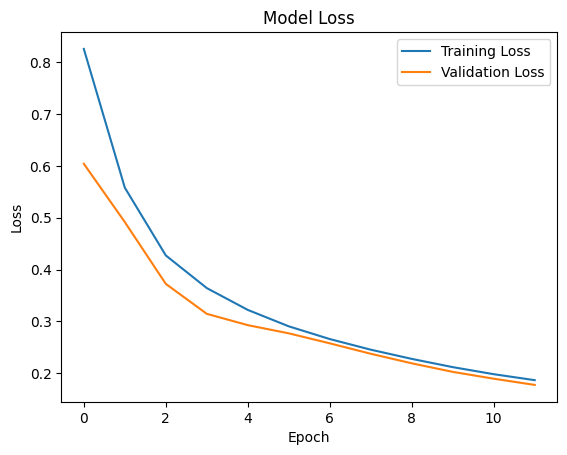

1/1 [==============================] - 0s 238ms/step - loss: 0.1592 - SSIMLoss: 0.1592
Test Loss: [0.159184992313385, 0.159184992313385]
1/1 [==============================] - 0s 53ms/step


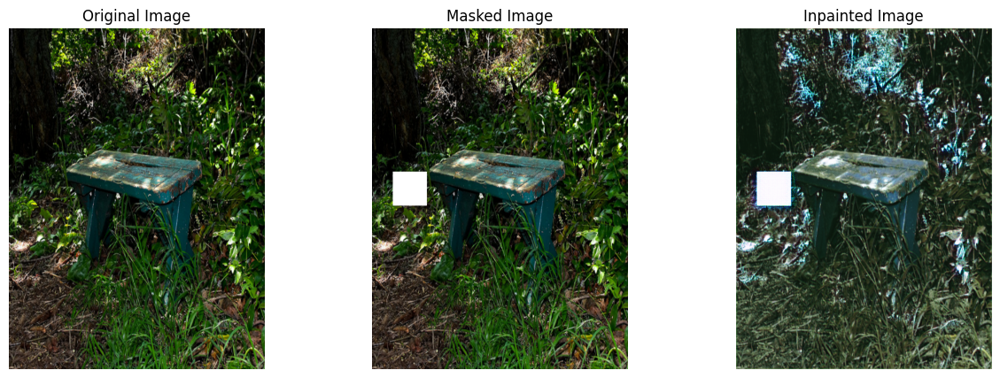

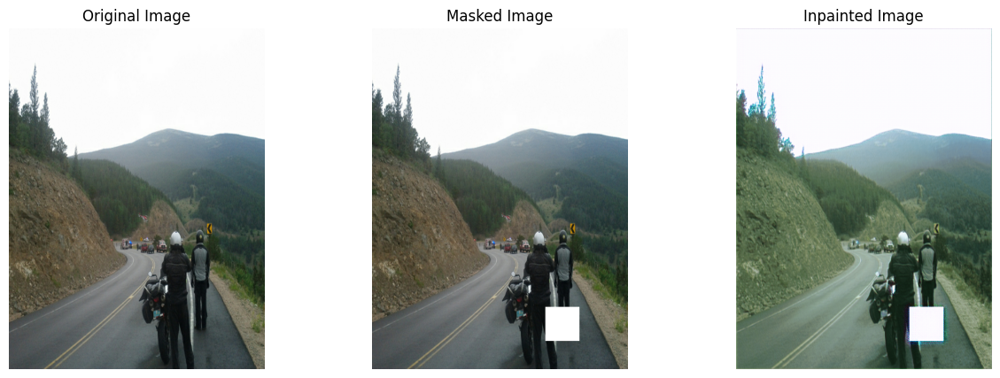

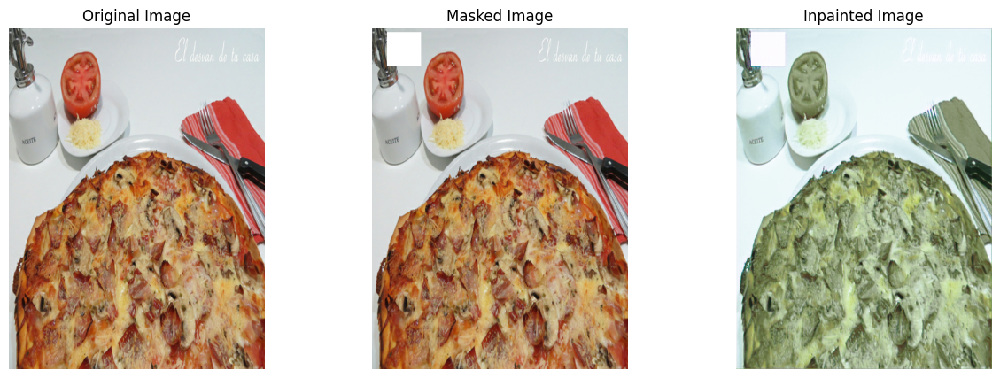

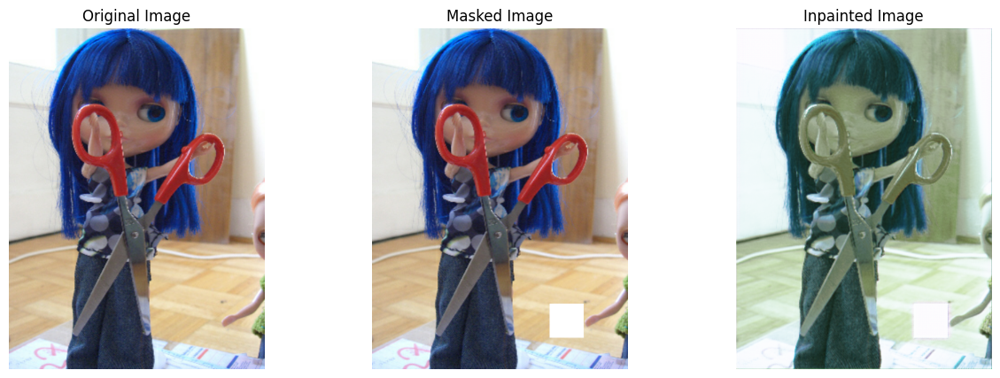

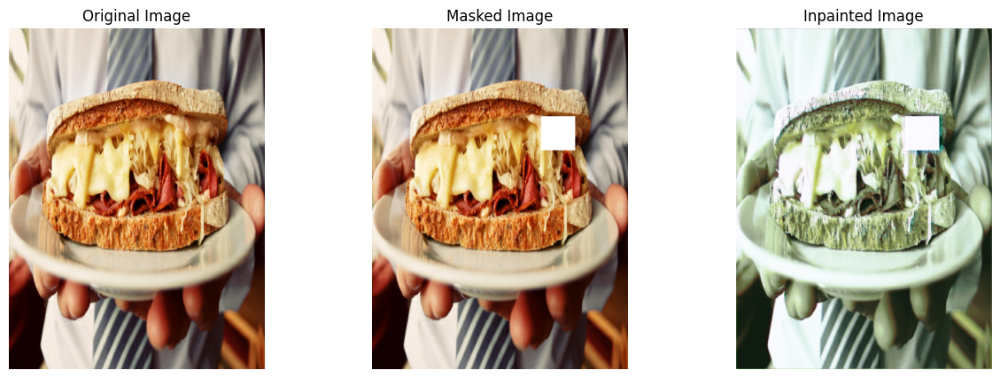

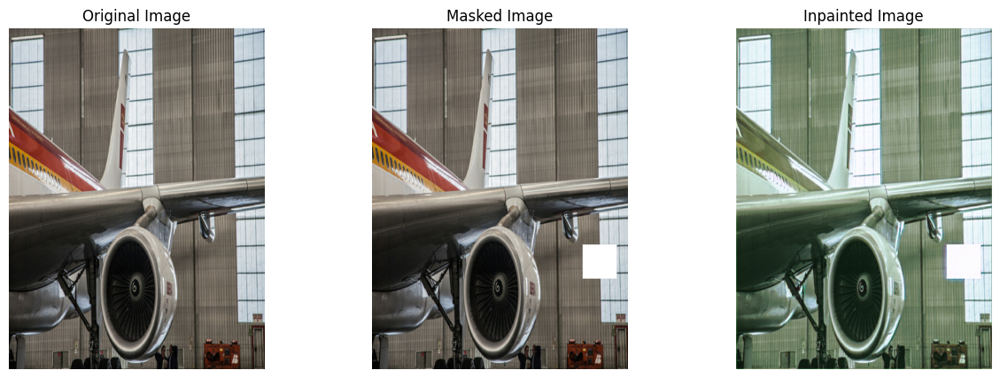

In [14]:
import os
import random
import tensorflow as tf
from tensorflow.keras import layers, models, callbacks
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from keras import backend as K

import matplotlib.pyplot as plt
import numpy as np

from skimage import metrics


def conv_block(input_tensor, num_filters):
    """Function for a convolutional block with BatchNormalization and ReLU activation"""
    encoder = layers.Conv2D(num_filters, (3, 3), padding='same')(input_tensor)
    encoder = layers.BatchNormalization()(encoder)
    encoder = layers.Activation('relu')(encoder)
    encoder = layers.Conv2D(num_filters, (3, 3), padding='same')(encoder)
    encoder = layers.BatchNormalization()(encoder)
    encoder = layers.Activation('relu')(encoder)
    return encoder

def encoder_block(input_tensor, num_filters):
    """Function for the encoder block"""
    encoder = conv_block(input_tensor, num_filters)
    encoder_pool = layers.MaxPooling2D((2, 2), strides=(2, 2))(encoder)
    return encoder_pool, encoder

def decoder_block(input_tensor, concat_tensor, num_filters):
    """Function for the decoder block"""
    decoder = layers.Conv2DTranspose(num_filters, (2, 2), strides=(2, 2), padding='same')(input_tensor)
    decoder = layers.concatenate([concat_tensor, decoder], axis=-1)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    decoder = layers.Conv2D(num_filters, (3, 3), padding='same')(decoder)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    decoder = layers.Conv2D(num_filters, (3, 3), padding='same')(decoder)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    return decoder

def unet_complex(input_size):
    inputs = tf.keras.Input(shape=input_size)

    # Encoding path
    encoder0_pool, encoder0 = encoder_block(inputs, 32)
    encoder1_pool, encoder1 = encoder_block(encoder0_pool, 64)
    encoder2_pool, encoder2 = encoder_block(encoder1_pool, 128)
    encoder3_pool, encoder3 = encoder_block(encoder2_pool, 256)
    encoder4_pool, encoder4 = encoder_block(encoder3_pool, 512)

    # Bottleneck
    center = conv_block(encoder4_pool, 1024)

    # Decoding path
    decoder4 = decoder_block(center, encoder4, 512)
    decoder3 = decoder_block(decoder4, encoder3, 256)
    decoder2 = decoder_block(decoder3, encoder2, 128)
    decoder1 = decoder_block(decoder2, encoder1, 64)
    decoder0 = decoder_block(decoder1, encoder0, 32)

    # Output layer
    outputs = layers.Conv2D(3, (1, 1), activation='sigmoid')(decoder0)  # Adjusted the output layer

    model = models.Model(inputs=[inputs], outputs=[outputs])
    return model



# Detect hardware, return appropriate distribution strategy
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()  # TPU detection
    print('Running on TPU ', tpu.master())
except ValueError:
    tpu = None

if tpu:
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)
else:
    strategy = tf.distribute.get_strategy()  # default strategy that works on CPU and single GPU

print("REPLICAS: ", strategy.num_replicas_in_sync)

class InpaintingDataGenerator:
    def __init__(self, image_dir, batch_size, num_samples=None, mask_size=(64, 64), target_size=(256, 256)):
        self.image_dir = image_dir
        self.image_names = os.listdir(image_dir)
        self.batch_size = batch_size
        self.mask_size = mask_size
        self.target_size = target_size
        if num_samples is not None and num_samples < len(self.image_names):
            self.image_names = random.sample(self.image_names, num_samples)
        self.dataset = self.create_dataset()
    
    def create_dataset(self):
        # Create a dataset of file paths
        path_dataset = tf.data.Dataset.from_tensor_slices(self.image_names)

        # Map the file paths to images, masks, and masked images
        image_dataset = path_dataset.map(
            lambda x: self.load_and_preprocess_image(
                self.image_dir, tf.strings.split(x, os.sep)[-1]  # Pass directory and filename separately
            ), 
            num_parallel_calls=tf.data.AUTOTUNE
        )

        # Unpack the tuple into separate elements
        image_dataset = image_dataset.map(lambda x, y: (x, y))

        # Batch and prefetch
        image_dataset = image_dataset.batch(self.batch_size)
        image_dataset = image_dataset.prefetch(buffer_size=tf.data.AUTOTUNE)

        return image_dataset
    
    def load_and_preprocess_image(self, dir_path, filename):
        # Combine the directory and filename to get the full path to the image
        img_path = tf.strings.join([dir_path, filename], separator='/')
        img = tf.io.read_file(img_path)
        img = tf.image.decode_jpeg(img, channels=3)
        img = tf.image.convert_image_dtype(img, tf.float32)
        img = tf.image.resize(img, self.target_size)
        # Create mask
        img_size = tf.shape(img)[:2]
        mask = tf.zeros((img_size[0], img_size[1], 1), dtype=tf.float32)
        top_left_x = tf.random.uniform((), 0, img_size[0] - self.mask_size[0], dtype=tf.int32)
        top_left_y = tf.random.uniform((), 0, img_size[1] - self.mask_size[1], dtype=tf.int32)
        bottom_right_x = top_left_x + self.mask_size[0]
        bottom_right_y = top_left_y + self.mask_size[1]

        # Generate indices for the mask
        indices = tf.reshape(
            tf.stack(
                tf.meshgrid(
                    tf.range(top_left_x, bottom_right_x),
                    tf.range(top_left_y, bottom_right_y),
                    indexing='ij'
                ),
                axis=-1
            ),
            (-1, 2)
        )
    
        # Create updates for the mask
        updates = tf.ones((self.mask_size[0] * self.mask_size[1], 1), dtype=tf.float32)

        # Update the mask tensor
        mask = tf.tensor_scatter_nd_update(mask, indices, updates)

        # Apply mask
        masked_img = img * (1 - mask) + mask

        # Return a tuple of two elements:
        # 1. the masked image (input to the model)
        # 2. the original image (ground truth for training)
        return masked_img, img

# Define directory paths and batch size
train_image_dir = '/kaggle/input/coco2017/train2017'
val_image_dir = '/kaggle/input/coco2017/val2017'
test_image_dir = '/kaggle/input/coco2017/test2017'
batch_size = 8 * strategy.num_replicas_in_sync  # Adjust batch size based on the number of TPU cores

    
# Initialize data generators
train_generator = InpaintingDataGenerator(train_image_dir, batch_size, num_samples=1000, target_size=(640, 480))
val_generator = InpaintingDataGenerator(val_image_dir, batch_size, target_size=(640, 480))
test_generator = InpaintingDataGenerator(test_image_dir, batch_size, target_size=(640, 480))

# losses
# check also mae i msa
# save all of the models for comparison
def SSIMLoss(y_true, y_pred):
    return 1 - tf.reduce_mean(tf.image.ssim(y_true, y_pred, 1.0))

def PSNR(y_true, y_pred):
    max_pixel = 1.0
    return (10.0 * K.log((max_pixel ** 2) / (K.mean(K.square(y_pred - y_true), axis=-1)))) / 2.303


# Initialize the complex U-Net model within the TPU strategy scope
with strategy.scope():
    final_model = unet_complex(input_size=(640, 480, 3))
    # It's crucial to compile the model within the strategy scope.
    final_model.compile(optimizer='adagrad', loss=SSIMLoss, metrics=[SSIMLoss])

    # After compiling, make a dummy prediction to check the output shape.
    dummy_input = tf.random.normal((1, 640, 480, 3))
    dummy_output = final_model.predict(dummy_input)
    print("Shape of dummy_output directly after model definition:", dummy_output.shape)

# Initialize callbacks
callbacks = [
    ModelCheckpoint('best_inpainting_model.tf', monitor='val_loss', save_best_only=True),
    EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
]


# Train the model
history = final_model.fit(
    train_generator.dataset,
    epochs=12,  # Training for 3 epochs as an example
    steps_per_epoch=min(1000, len(train_generator.image_names)) // batch_size,
    validation_data=val_generator.dataset,
    validation_steps=min(300, len(val_generator.image_names)) // batch_size,
    callbacks=callbacks
)


# Plot training history
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()
plt.show()

# Evaluate on test set
for sample in test_generator.dataset.take(1):
    masked_images, original_images = sample
    test_loss = final_model.evaluate(masked_images, original_images)
    print(f'Test Loss: {test_loss}')

# Display inpainting results
def display_inpainting_results(model, generator, num_samples=3):
    # Take one batch from the dataset
    for sample in generator.dataset.take(1):
        masked_images, original_images = sample

        # Predict inpainted images
        inpainted_images = model.predict(masked_images)

        # Display the results for the specified number of samples
        for i in range(min(num_samples, masked_images.shape[0])):
            plt.figure(figsize=(15, 5))
            
            # Display original image
            plt.subplot(1, 3, 1)
            plt.imshow(original_images[i].numpy() if isinstance(original_images[i], tf.Tensor) else original_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Original Image')
            plt.axis('off')
            
            # Display masked image
            plt.subplot(1, 3, 2)
            plt.imshow(masked_images[i].numpy() if isinstance(masked_images[i], tf.Tensor) else masked_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Masked Image')
            plt.axis('off')
            
            # Display inpainted image
            plt.subplot(1, 3, 3)
            plt.imshow(inpainted_images[i].numpy() if isinstance(inpainted_images[i], tf.Tensor) else inpainted_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Inpainted Image')
            plt.axis('off')
            plt.show()

display_inpainting_results(final_model, test_generator, num_samples=6)

# VISUALISING THE STANDARD ARCHITECTURE (U-Net inspired):

Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_6 (InputLayer)        [(None, 640, 480, 3)]        0         []                            
                                                                                                  
 conv2d_109 (Conv2D)         (None, 640, 480, 32)         896       ['input_6[0][0]']             
                                                                                                  
 batch_normalization_110 (B  (None, 640, 480, 32)         128       ['conv2d_109[0][0]']          
 atchNormalization)                                                                               
                                                                                                  
 activation_109 (Activation  (None, 640, 480, 32)         0         ['batch_normalization_11

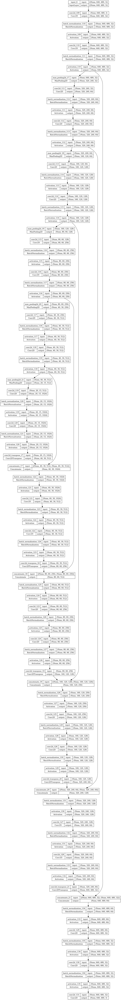

In [8]:
model = unet_complex(input_size=(640, 480, 3))
model.summary()

from tensorflow.keras.utils import plot_model
plot_model(model, to_file='model_architecture.png', show_shapes=True, show_layer_names=True)

# NEW, BIGGER MODEL:

REPLICAS:  1
1/1 [==============================] - 1s 613ms/step
Shape of dummy_output directly after model definition: (1, 640, 480, 3)
Epoch 1/15


2024-02-02 11:57:22.169910: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel_9/dropout_20/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


500/500 [==============================] - 301s 551ms/step - loss: 0.0127 - SSIMLoss: 0.3306 - val_loss: 0.0094 - val_SSIMLoss: 0.2176
Epoch 2/15
500/500 [==============================] - 274s 548ms/step - loss: 0.0073 - SSIMLoss: 0.2427 - val_loss: 0.0065 - val_SSIMLoss: 0.1091
Epoch 3/15
500/500 [==============================] - 274s 549ms/step - loss: 0.0059 - SSIMLoss: 0.2158 - val_loss: 0.0061 - val_SSIMLoss: 0.1029
Epoch 4/15
500/500 [==============================] - 273s 547ms/step - loss: 0.0050 - SSIMLoss: 0.2004 - val_loss: 0.0060 - val_SSIMLoss: 0.0918
Epoch 5/15
500/500 [==============================] - 258s 516ms/step - loss: 0.0043 - SSIMLoss: 0.1895 - val_loss: 0.0068 - val_SSIMLoss: 0.1034
Epoch 6/15
500/500 [==============================] - 258s 516ms/step - loss: 0.0039 - SSIMLoss: 0.1814 - val_loss: 0.0063 - val_SSIMLoss: 0.0954
Epoch 7/15
500/500 [==============================] - 260s 520ms/step - loss: 0.0035 - SSIMLoss: 0.1732 - val_loss: 0.0063 - val_SSIMLo

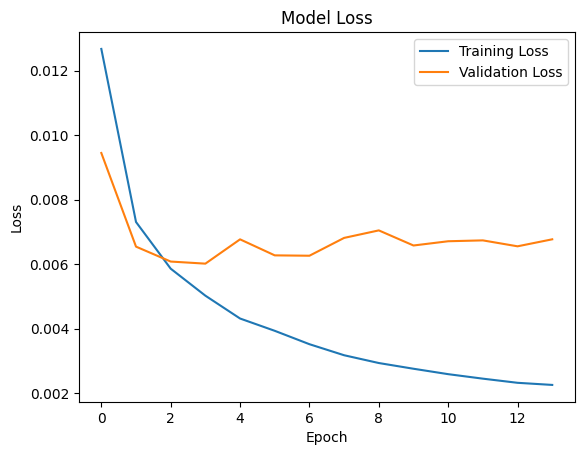

1/1 [==============================] - 0s 155ms/step - loss: 0.0096 - SSIMLoss: 0.0994
Test Loss: [0.009640390984714031, 0.09942734241485596]
1/1 [==============================] - 0s 32ms/step


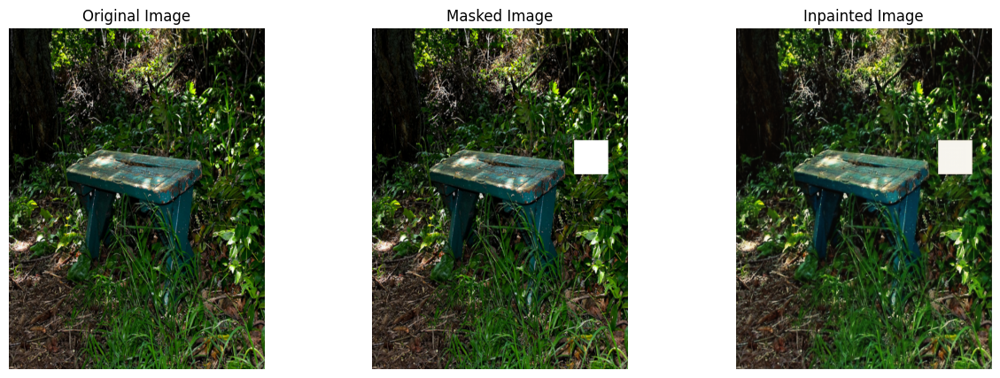

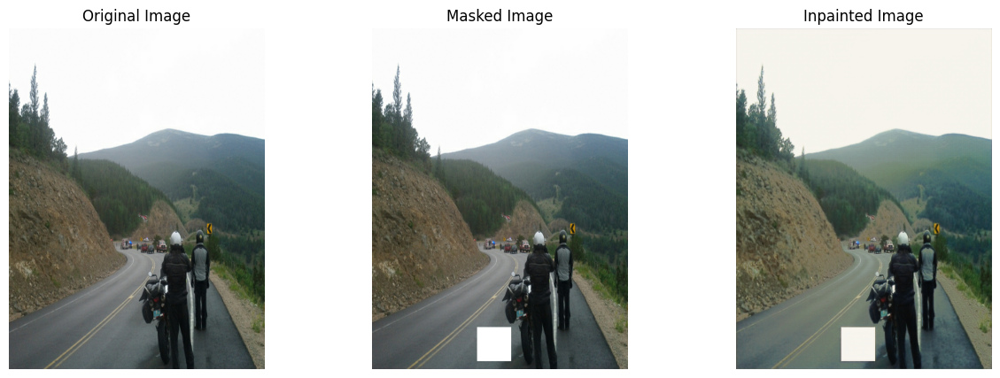

In [10]:
import os
import random
import tensorflow as tf
from tensorflow.keras import layers, models, callbacks
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from keras import backend as K

import matplotlib.pyplot as plt
import numpy as np

from skimage import metrics


def conv_block(input_tensor, num_filters, use_dropout=True, dropout_rate=0.5):
    """Function for a convolutional block with BatchNormalization, ReLU activation, and optional Dropout"""
    x = layers.Conv2D(num_filters, (3, 3), padding='same')(input_tensor)
    x = layers.BatchNormalization()(x)
    x = layers.Activation('relu')(x)
    x = layers.Conv2D(num_filters, (3, 3), padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.Activation('relu')(x)
    
    if use_dropout:
        x = layers.Dropout(dropout_rate)(x)
    
    # Optional: Introduce residual connection
    # if input_tensor.shape[-1] == num_filters:
    #     x = layers.add([x, input_tensor])
    
    return x

def encoder_block(input_tensor, num_filters):
    """Function for the encoder block"""
    encoder = conv_block(input_tensor, num_filters)
    encoder_pool = layers.MaxPooling2D((2, 2), strides=(2, 2))(encoder)
    return encoder_pool, encoder

def decoder_block(input_tensor, concat_tensor, num_filters):
    """Function for the decoder block"""
    decoder = layers.Conv2DTranspose(num_filters, (2, 2), strides=(2, 2), padding='same')(input_tensor)
    decoder = layers.concatenate([concat_tensor, decoder], axis=-1)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    decoder = layers.Conv2D(num_filters, (3, 3), padding='same')(decoder)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    decoder = layers.Conv2D(num_filters, (3, 3), padding='same')(decoder)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    return decoder

def unet_complex(input_size):
    inputs = tf.keras.Input(shape=input_size)

    # Encoding path
    encoder0_pool, encoder0 = encoder_block(inputs, 64)  # Increased number of filters
    encoder1_pool, encoder1 = encoder_block(encoder0_pool, 128)
    encoder2_pool, encoder2 = encoder_block(encoder1_pool, 256)
    encoder3_pool, encoder3 = encoder_block(encoder2_pool, 512)
    encoder4_pool, encoder4 = encoder_block(encoder3_pool, 1024)

    # Bottleneck
    center = conv_block(encoder4_pool, 2048, use_dropout=True)  # Increased number of filters and added dropout

    # Decoding path
    decoder4 = decoder_block(center, encoder4, 1024)
    decoder3 = decoder_block(decoder4, encoder3, 512)
    decoder2 = decoder_block(decoder3, encoder2, 256)
    decoder1 = decoder_block(decoder2, encoder1, 128)
    decoder0 = decoder_block(decoder1, encoder0, 64)

    # Output layer
    outputs = layers.Conv2D(3, (1, 1), activation='sigmoid')(decoder0)

    model = models.Model(inputs=[inputs], outputs=[outputs])
    return model


# Detect hardware, return appropriate distribution strategy
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()  # TPU detection
    print('Running on TPU ', tpu.master())
except ValueError:
    tpu = None

if tpu:
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)
else:
    strategy = tf.distribute.get_strategy()  # default strategy that works on CPU and single GPU

print("REPLICAS: ", strategy.num_replicas_in_sync)

class InpaintingDataGenerator:
    def __init__(self, image_dir, batch_size, num_samples=None, mask_size=(64, 64), target_size=(256, 256)):
        self.image_dir = image_dir
        self.image_names = os.listdir(image_dir)
        self.batch_size = batch_size
        self.mask_size = mask_size
        self.target_size = target_size
        if num_samples is not None and num_samples < len(self.image_names):
            self.image_names = random.sample(self.image_names, num_samples)
        self.dataset = self.create_dataset()
    
    def create_dataset(self):
        # Create a dataset of file paths
        path_dataset = tf.data.Dataset.from_tensor_slices(self.image_names)

        # Map the file paths to images, masks, and masked images
        image_dataset = path_dataset.map(
            lambda x: self.load_and_preprocess_image(
                self.image_dir, tf.strings.split(x, os.sep)[-1]  # Pass directory and filename separately
            ), 
            num_parallel_calls=tf.data.AUTOTUNE
        )

        # Unpack the tuple into separate elements
        image_dataset = image_dataset.map(lambda x, y: (x, y))

        # Batch and prefetch
        image_dataset = image_dataset.batch(self.batch_size)
        image_dataset = image_dataset.prefetch(buffer_size=tf.data.AUTOTUNE)

        return image_dataset
    
    def load_and_preprocess_image(self, dir_path, filename):
        # Combine the directory and filename to get the full path to the image
        img_path = tf.strings.join([dir_path, filename], separator='/')
        img = tf.io.read_file(img_path)
        img = tf.image.decode_jpeg(img, channels=3)
        img = tf.image.convert_image_dtype(img, tf.float32)
        img = tf.image.resize(img, self.target_size)
        # Create mask
        img_size = tf.shape(img)[:2]
        mask = tf.zeros((img_size[0], img_size[1], 1), dtype=tf.float32)
        top_left_x = tf.random.uniform((), 0, img_size[0] - self.mask_size[0], dtype=tf.int32)
        top_left_y = tf.random.uniform((), 0, img_size[1] - self.mask_size[1], dtype=tf.int32)
        bottom_right_x = top_left_x + self.mask_size[0]
        bottom_right_y = top_left_y + self.mask_size[1]

        # Generate indices for the mask
        indices = tf.reshape(
            tf.stack(
                tf.meshgrid(
                    tf.range(top_left_x, bottom_right_x),
                    tf.range(top_left_y, bottom_right_y),
                    indexing='ij'
                ),
                axis=-1
            ),
            (-1, 2)
        )
    
        # Create updates for the mask
        updates = tf.ones((self.mask_size[0] * self.mask_size[1], 1), dtype=tf.float32)

        # Update the mask tensor
        mask = tf.tensor_scatter_nd_update(mask, indices, updates)

        # Apply mask
        masked_img = img * (1 - mask) + mask

        # Return a tuple of two elements:
        # 1. the masked image (input to the model)
        # 2. the original image (ground truth for training)
        return masked_img, img

# Define directory paths and batch size
train_image_dir = '/kaggle/input/coco2017/train2017'
#train_image_dir = '/kaggle/input/coco-2017-dataset/coco2017/train2017'
val_image_dir = '/kaggle/input/coco2017/val2017'
test_image_dir = '/kaggle/input/coco2017/test2017'
batch_size = 2 * strategy.num_replicas_in_sync  # Adjust batch size based on the number of TPU cores

    
# Initialize data generators
train_generator = InpaintingDataGenerator(train_image_dir, batch_size, num_samples=1000, target_size=(640, 480))
val_generator = InpaintingDataGenerator(val_image_dir, batch_size, target_size=(640, 480))
test_generator = InpaintingDataGenerator(test_image_dir, batch_size, target_size=(640, 480))

# losses
# check also mae i msa
# save all of the models for comparison
def SSIMLoss(y_true, y_pred):
    return 1 - tf.reduce_mean(tf.image.ssim(y_true, y_pred, 1.0))

def PSNR(y_true, y_pred):
    max_pixel = 1.0
    return (10.0 * K.log((max_pixel ** 2) / (K.mean(K.square(y_pred - y_true), axis=-1)))) / 2.303


# Initialize the complex U-Net model within the TPU strategy scope
with strategy.scope():
    final_model = unet_complex(input_size=(640, 480, 3))
    # It's crucial to compile the model within the strategy scope.
    final_model.compile(optimizer='rmsprop', loss='mse', metrics=[SSIMLoss, PSNR])

    # After compiling, make a dummy prediction to check the output shape.
    dummy_input = tf.random.normal((1, 640, 480, 3))
    dummy_output = final_model.predict(dummy_input)
    print("Shape of dummy_output directly after model definition:", dummy_output.shape)

# Initialize callbacks
callbacks = [
    ModelCheckpoint('best_inpainting_model.tf', monitor='val_loss', save_best_only=True),
    EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
]


# Train the model
history = final_model.fit(
    train_generator.dataset,
    epochs=15,  # Training for 3 epochs as an example
    steps_per_epoch=min(1000, len(train_generator.image_names)) // batch_size,
    validation_data=val_generator.dataset,
    validation_steps=min(300, len(val_generator.image_names)) // batch_size,
    callbacks=callbacks
)


# Plot training history
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()
plt.show()

# # Evaluate on test set
# test_loss = final_model.evaluate(
#     test_generator.dataset,
#     steps=len(test_generator.image_names) // batch_size
# )

# Evaluate on test set
for sample in test_generator.dataset.take(1):
    masked_images, original_images = sample
    test_loss = final_model.evaluate(masked_images, original_images)
    print(f'Test Loss: {test_loss}')

# Display inpainting results
def display_inpainting_results(model, generator, num_samples=3):
    # Take one batch from the dataset
    for sample in generator.dataset.take(1):
        masked_images, original_images = sample

        # Predict inpainted images
        inpainted_images = model.predict(masked_images)

        # Display the results for the specified number of samples
        for i in range(min(num_samples, masked_images.shape[0])):
            plt.figure(figsize=(15, 5))
            
            # Display original image
            plt.subplot(1, 3, 1)
            plt.imshow(original_images[i].numpy() if isinstance(original_images[i], tf.Tensor) else original_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Original Image')
            plt.axis('off')
            
            # Display masked image
            plt.subplot(1, 3, 2)
            plt.imshow(masked_images[i].numpy() if isinstance(masked_images[i], tf.Tensor) else masked_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Masked Image')
            plt.axis('off')
            
            # Display inpainted image
            plt.subplot(1, 3, 3)
            plt.imshow(inpainted_images[i].numpy() if isinstance(inpainted_images[i], tf.Tensor) else inpainted_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Inpainted Image')
            plt.axis('off')
            plt.show()

display_inpainting_results(final_model, test_generator, num_samples=6)

# VISUALIZING THE BIGGER MODEL:

Model: "model_6"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_8 (InputLayer)        [(None, 640, 480, 3)]        0         []                            
                                                                                                  
 conv2d_155 (Conv2D)         (None, 640, 480, 64)         1792      ['input_8[0][0]']             
                                                                                                  
 batch_normalization_164 (B  (None, 640, 480, 64)         256       ['conv2d_155[0][0]']          
 atchNormalization)                                                                               
                                                                                                  
 activation_163 (Activation  (None, 640, 480, 64)         0         ['batch_normalization_16

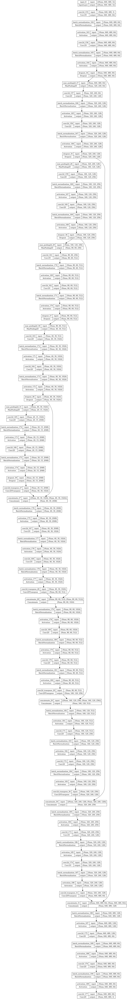

In [12]:
# Initialize the model
input_size = (640, 480, 3)
model = unet_complex(input_size)


# Show the model summary
model.summary()


# Display the model architecture diagram
plot_model(model, to_file='/kaggle/working//unet_complex_model.png', show_shapes=True, show_layer_names=True)